# Optimizing DETR for Pole Detection

The following notebook should be run to replicate the training of the DETR model on our custom dataset of electric pole images and their corresponding annotations (COCO JSON files). Please run in Google Colab or on a PC with a GPU for best results.

This fine-tuning references methods from the following Github Repo: https://github.com/woctezuma/finetune-detr

## Feature Initialization

Initialize the functions and variables required throughout the notebook to work with COCO JSON annotations and the DETR model.

In [1]:
# Import torch and ensure that CUDA is available. If not, please run on Google Colab
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())

torch.set_grad_enabled(False);

2.1.0+cu121 True


In [2]:
import torchvision.transforms as T
import matplotlib.pyplot as plt

# PyTorch image normalization
transform = T.Compose([
    T.Resize(800),
    T.ToTensor(),
    T.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

# Functions to process bounding boxes in image outputs
def box_cxcywh_to_xyxy(x):
    x_c, y_c, w, h = x.unbind(1)
    b = [(x_c - 0.5 * w), (y_c - 0.5 * h),
         (x_c + 0.5 * w), (y_c + 0.5 * h)]
    return torch.stack(b, dim=1)

def rescale_bboxes(out_bbox, size):
    img_w, img_h = size
    b = box_cxcywh_to_xyxy(out_bbox)
    b = b * torch.tensor([img_w, img_h, img_w, img_h], dtype=torch.float32)
    return b

In [3]:
# Filter the bounding boxes that have low confidence with default threshold = 0.7
def filter_bboxes_from_outputs(outputs,threshold=0.7):

    # Retain predictions above the given threshold
    probas = outputs['pred_logits'].softmax(-1)[0, :, :-1]
    keep = probas.max(-1).values > threshold

    probas_to_keep = probas[keep]

    # Scale bounding boxes
    bboxes_scaled = rescale_bboxes(outputs['pred_boxes'][0, keep], im.size)

    return probas_to_keep, bboxes_scaled

## Clone DETR Branch

Clone the following DETR [fork](https://github.com/woctezuma/detr/tree/finetune) which will allow for training on a custom dataset.

In [ ]:
# ONLY run if running outside of Google Colab
!mkdir -p content

In [4]:
# Run this cell regardless of server
%cd /content/

!rm -rf detr
!git clone https://github.com/woctezuma/detr.git

%cd detr/

!git checkout finetune

/content
Cloning into 'detr'...
remote: Enumerating objects: 263, done.
remote: Counting objects: 100% (10/10), done.
remote: Compressing objects: 100% (7/7), done.
remote: Total 263 (delta 4), reused 5 (delta 3), pack-reused 253
Receiving objects: 100% (263/263), 324.61 KiB | 3.15 MiB/s, done.
Resolving deltas: 100% (126/126), done.
/content/detr
Already on 'finetune'
Your branch is up to date with 'origin/finetune'.


## Initialize Pre-Trained Weights

Load a pre-trained model checkpoint for DETR so that we can utilize the model without training it on a large dataset. This is particularly useful in light of fine-tuning the model.

Different DETR checkpoint URL's can be found here:https://github.com/facebookresearch/detr#model-zoo

In [5]:
# Get pretrained weights
checkpoint = torch.hub.load_state_dict_from_url(
            url='https://dl.fbaipublicfiles.com/detr/detr-r50-e632da11.pth',
            map_location='cpu',
            check_hash=True)

# Remove class weights
del checkpoint["model"]["class_embed.weight"]
del checkpoint["model"]["class_embed.bias"]

torch.save(checkpoint,
           'detr-r50_no-class-head.pth')

Downloading: "https://dl.fbaipublicfiles.com/detr/detr-r50-e632da11.pth" to /root/.cache/torch/hub/checkpoints/detr-r50-e632da11.pth
100%|██████████| 159M/159M [00:01<00:00, 146MB/s]


## Create Necessary Directories

Run the following cell to create a series of needed directories.

In [6]:
# Create a series of directories for data to be stored
!mkdir -p /content/data/structures/annotations/
!mkdir -p /content/data/structures/train2017/
!mkdir -p /content/data/structures/val2017/
!mkdir -p /content/data/structures/valjpg/

In order for the DETR model to be trained, please now upload:
- custom_train.json found in the annotation folder in the repo
- custom_val.json found in the annotation folder in the repo
- All training images found in the data/training folder in the repo
- All validation images found in the data/validation folder in the repo

The directory structure should reflect the following:
```
path/to/coco/
├ annotations/  # JSON annotations
│  ├ annotations/custom_train.json
│  └ annotations/custom_val.json
├ train2017/    # training images
├ val2017/      # validation images
└ valjpg/      # converted png to jpg images
```

PNG images are not compatible with output in the notebook. Thus, we must convert PNG images in the validation set to JPGs. These will be stored in the following folder: ```/content/data/structures/valjpg/ ```

In [7]:
from PIL import Image
import os
from os import listdir

# Convert the png validation images to jpg
directory = '/content/data/structures/val2017/'
new_directory = '/content/data/structures/valjpg/'

for image in os.listdir(directory):

    # Check if the image ends with PNG
    if (image.endswith(".PNG")):
        image_path = directory + image

        # Open image in PNG format
        img_png = Image.open(image_path)
        new_png = img_png.convert('RGB')

        #The image object is used to save the image in jpg format
        new_png.save(new_directory + image[:-4] + '_mod.jpg')

## Load In and Demo Custom Data Set

To ensure that the structure data has been loaded in correctly, we will display the annotations of randomly selected samples in the training set:
-   Reference of COCO API Functionality: https://github.com/cocodataset/cocoapi/blob/master/PythonAPI/pycocoDemo.ipynb

In [8]:
# Select 0 or 1 to begin indexing image categories. We will begin with 1
first_class_index = 1

In [9]:
# Import necessary packages
%matplotlib inline
from pycocotools.coco import COCO
import numpy as np
import skimage.io as io
import matplotlib.pyplot as plt
import pylab
pylab.rcParams['figure.figsize'] = (10.0, 8.0)

In [10]:
# Initialize filepaths to the training data and train JSON
dataDir='/content/data/structures/'
dataType='train2017'
annFile='{}annotations/custom_train.json'.format(dataDir)

In [11]:
# Load the training JSON file through COCO
coco=COCO(annFile)

loading annotations into memory...
Done (t=0.01s)
creating index...
index created!


In [12]:
# Observe COCO categories and supercategories
cats = coco.loadCats(coco.getCatIds())

nms=[cat['name'] for cat in cats]
print('Categories: {}'.format(nms))

nms = set([cat['supercategory'] for cat in cats])
print('Super-categories: {}'.format(nms))

Categories: ['OH']
Super-categories: {''}


Above, we observe that in our image labeling, there exists only one label category:
- OH: Overhead Structures (poles)

There exist no super-categories or overarching categories of structures.

In [13]:
# Load the image and category ID
catIds = coco.getCatIds(catNms=['OH']);
imgIds = coco.getImgIds(catIds=catIds );

Image n°450
Image name: /content/data/structures//train2017/Frame 40.JPEG


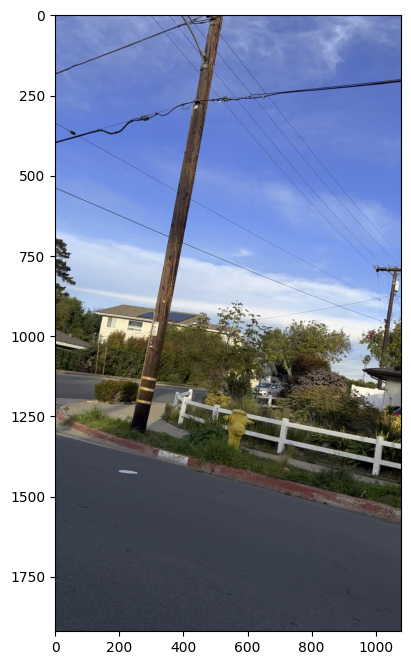

In [15]:
# Choose a random image from the training set and display
img_id = imgIds[np.random.randint(0,len(imgIds))]
print('Image n°{}'.format(img_id))

img = coco.loadImgs(img_id)[0]

img_name = '%s/%s/%s'%(dataDir, dataType, img['file_name'])
print('Image name: {}'.format(img_name))

I = io.imread(img_name)
plt.figure()
plt.imshow(I)

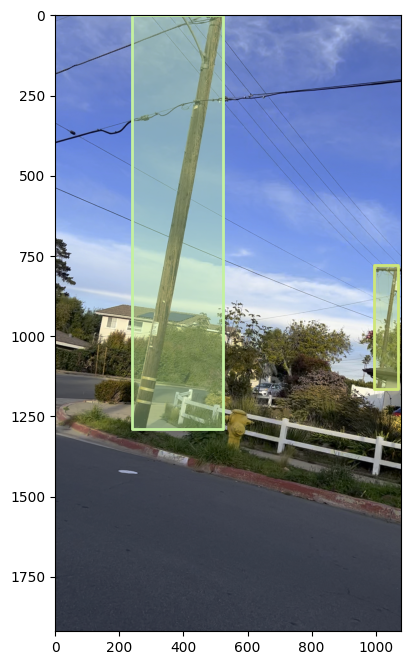

In [16]:
# Obtain the annotations/label that correspond with this image
annIds = coco.getAnnIds(imgIds=img['id'], catIds=catIds)
anns = coco.loadAnns(annIds)

# Display the image with its bounding box(es)
plt.imshow(I)
coco.showAnns(anns, draw_bbox=True)

Above, we see a randomly selected image from our training set and bounding boxes around poles. These boxes are derived from our COCO JSON file, wherein boxes were manually bound for the purpose of training the DETR model.

## Fine-tuning DETR with Custom Data Set

In [17]:
assert(first_class_index in [0, 1])

if first_class_index == 0:
    # There is one class (OH) with ID n°1.
    num_classes = 1
    finetuned_classes = ['OH']

else:
    # DETR assumes that indexing starts with 0, so there is a dummy class with ID n°0.
    num_classes = 2
    finetuned_classes = ['N/A', 'OH']

print('First class index: {}'.format(first_class_index))
print('Parameter num_classes: {}'.format(num_classes))
print('Fine-tuned classes: {}'.format(finetuned_classes))

First class index: 1
Parameter num_classes: 2
Fine-tuned classes: ['N/A', 'OH']


In [18]:
# Enter detr directory
%cd /content/detr/

/content/detr


Run the following cell to train the model on the training dataset on 10 epochs.

In [19]:
# Train the DETR model on our custom dataset
!python main.py \
  --dataset_file "custom" \
  --coco_path "/content/data/structures/" \
  --output_dir "outputs" \
  --resume "detr-r50_no-class-head.pth" \
  --num_classes $num_classes \
  --epochs 10

Not using distributed mode
git:
  sha: e891373a8cab93d3719afb0acff28de94c6dc6a3, status: clean, branch: finetune

Namespace(lr=0.0001, lr_backbone=1e-05, batch_size=2, weight_decay=0.0001, epochs=10, lr_drop=200, clip_max_norm=0.1, frozen_weights=None, backbone='resnet50', dilation=False, position_embedding='sine', enc_layers=6, dec_layers=6, dim_feedforward=2048, hidden_dim=256, dropout=0.1, nheads=8, num_queries=100, pre_norm=False, masks=False, aux_loss=True, set_cost_class=1, set_cost_bbox=5, set_cost_giou=2, mask_loss_coef=1, dice_loss_coef=1, bbox_loss_coef=5, giou_loss_coef=2, eos_coef=0.1, num_classes=2, dataset_file='custom', coco_path='/content/data/structures/', coco_panoptic_path=None, remove_difficult=False, output_dir='outputs', device='cuda', seed=42, resume='detr-r50_no-class-head.pth', start_epoch=0, eval=False, num_workers=2, world_size=1, dist_url='env://', distributed=False)
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The p

## Observation of Model Results

### Training Results

Reference: https://github.com/lessw2020/Thunder-Detr/blob/master/View_your_training_results.ipynb

In [20]:
# Import necessary packages
from util.plot_utils import plot_logs

from pathlib import Path

log_directory = [Path('outputs/')]

As mentioned in the code of [`plot_logs`](https://github.com/facebookresearch/detr/blob/5e66b4cd15b2b182da347103dd16578d28b49d69/util/plot_utils.py#L13):
-   Solid lines in graphs indicate training results
-   Dashed lines in graphs indicate validation results

/content/detr/util/plot_utils.py:65: FutureWarning: Dropping of nuisance columns in rolling operations is deprecated; in a future version this will raise TypeError. Select only valid columns before calling the operation. Dropped columns were Index(['test_coco_eval_bbox'], dtype='object')
  df.interpolate().ewm(com=ewm_col).mean().plot(


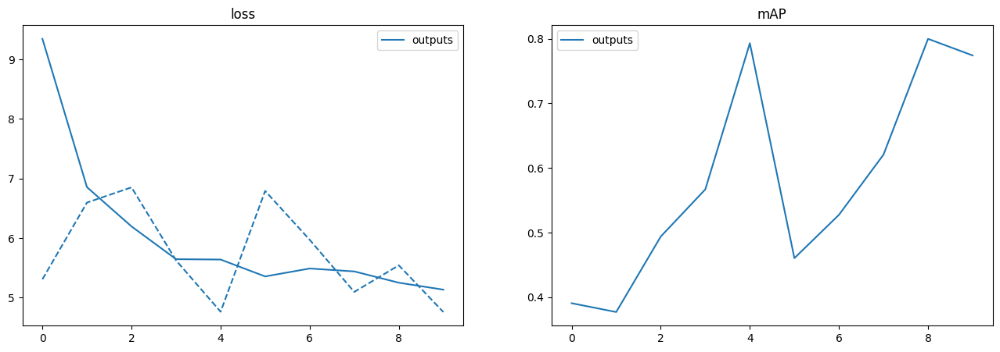

In [53]:
# Plot the loss and mAP (mean average precision) over 10 epochs
fields_of_interest = (
    'loss',
    'mAP',
    )

plot_logs(log_directory,
          fields_of_interest)

/content/detr/util/plot_utils.py:65: FutureWarning: Dropping of nuisance columns in rolling operations is deprecated; in a future version this will raise TypeError. Select only valid columns before calling the operation. Dropped columns were Index(['test_coco_eval_bbox'], dtype='object')
  df.interpolate().ewm(com=ewm_col).mean().plot(
/content/detr/util/plot_utils.py:65: FutureWarning: Dropping of nuisance columns in rolling operations is deprecated; in a future version this will raise TypeError. Select only valid columns before calling the operation. Dropped columns were Index(['test_coco_eval_bbox'], dtype='object')
  df.interpolate().ewm(com=ewm_col).mean().plot(
/content/detr/util/plot_utils.py:65: FutureWarning: Dropping of nuisance columns in rolling operations is deprecated; in a future version this will raise TypeError. Select only valid columns before calling the operation. Dropped columns were Index(['test_coco_eval_bbox'], dtype='object')
  df.interpolate().ewm(com=ewm_col)

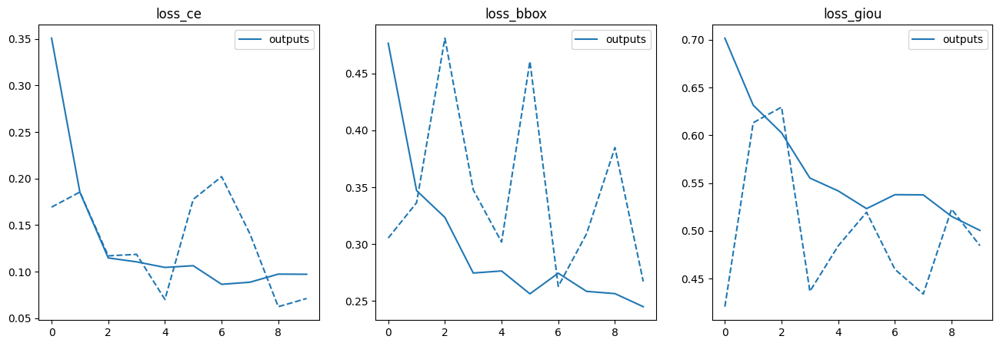

In [54]:
# Plot the class error, bounding box, and GIOU (Generalized Intersection Over Union) losses
fields_of_interest = (
    'loss_ce',
    'loss_bbox',
    'loss_giou',
    )

plot_logs(log_directory,
          fields_of_interest)

/content/detr/util/plot_utils.py:65: FutureWarning: Dropping of nuisance columns in rolling operations is deprecated; in a future version this will raise TypeError. Select only valid columns before calling the operation. Dropped columns were Index(['test_coco_eval_bbox'], dtype='object')
  df.interpolate().ewm(com=ewm_col).mean().plot(
/content/detr/util/plot_utils.py:65: FutureWarning: Dropping of nuisance columns in rolling operations is deprecated; in a future version this will raise TypeError. Select only valid columns before calling the operation. Dropped columns were Index(['test_coco_eval_bbox'], dtype='object')
  df.interpolate().ewm(com=ewm_col).mean().plot(


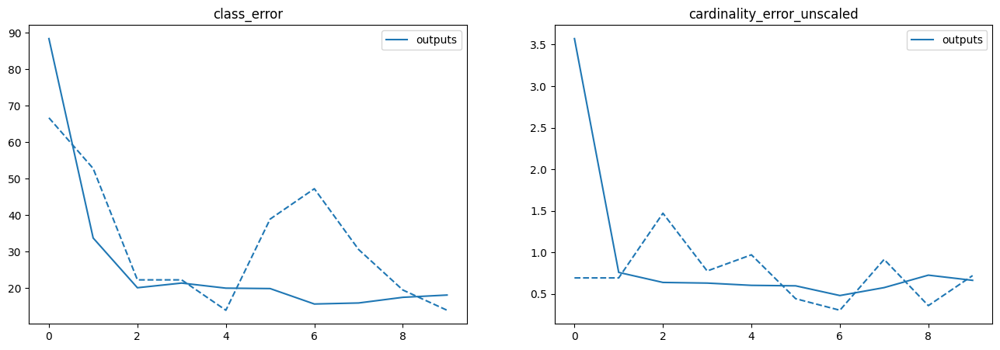

In [56]:
# Plot the class error and cardinality error
fields_of_interest = (
    'class_error',
    'cardinality_error_unscaled',
    )

plot_logs(log_directory,
          fields_of_interest)

### Load the Fine-Tuned Model

In [25]:
# Load the fine-tuned model to display results
model = torch.hub.load('facebookresearch/detr',
                       'detr_resnet50',
                       pretrained=False,
                       num_classes=num_classes)

checkpoint = torch.load('outputs/checkpoint.pth',
                        map_location='cpu')

model.load_state_dict(checkpoint['model'],
                      strict=False)

model.eval();

Downloading: "https://github.com/facebookresearch/detr/zipball/main" to /root/.cache/torch/hub/main.zip
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


### Display Fine-tuned Results

In [41]:
# Helper function to display results
def plot_finetuned_results(pil_img, img_name, prob=None, boxes=None):
    plt.figure(figsize=(16,10))
    plt.imshow(pil_img)
    ax = plt.gca()
    colors = COLORS * 100
    if prob is not None and boxes is not None:
        for p, (xmin, ymin, xmax, ymax), c in zip(prob, boxes.tolist(), colors):
            ax.add_patch(plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin,
                                    fill=False, color=c, linewidth=3))
            cl = p.argmax()
            text = f'{finetuned_classes[cl]}: {p[cl]:0.2f}'
            ax.text(xmin, ymin, text, fontsize=15,
                  bbox=dict(facecolor='yellow', alpha=0.5))
    plt.axis('off')
    plt.savefig(img_name)
    plt.show()

In [37]:
# Run the given image on the fine-tuned model
def run_worflow(my_image, my_model, img_name_root):
    # mean-std normalize the input image (batch-size: 1)
    img = transform(my_image).unsqueeze(0)

    # propagate through the model
    outputs = my_model(img)

    img_tag = 1
    for threshold in [0.9, 0.7]:
        probas_to_keep, bboxes_scaled = filter_bboxes_from_outputs(outputs,
                                                                threshold=threshold)
        img_name = img_name_root + str(img_tag) + ".png"
        plot_finetuned_results(my_image,img_name,
                              probas_to_keep,
                              bboxes_scaled)
        img_tag += 1

In [38]:
# Save model result images in "finetuned" directory
!mkdir -p /content/data/structures/finetuned/

### Display Training Image Results

In [39]:
# Colors for COCO visualization
COLORS = [[0.000, 0.447, 0.741], [0.850, 0.325, 0.098], [0.929, 0.694, 0.125],
          [0.494, 0.184, 0.556], [0.466, 0.674, 0.188], [0.301, 0.745, 0.933]]

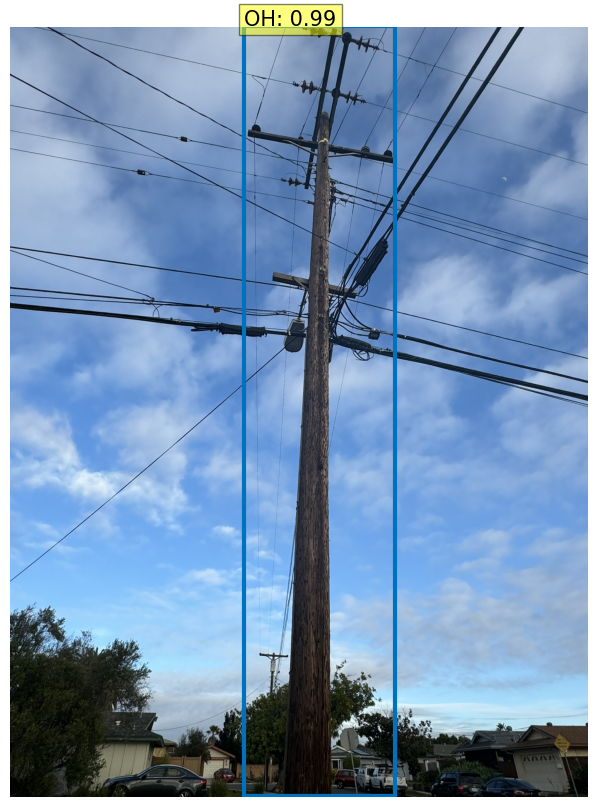

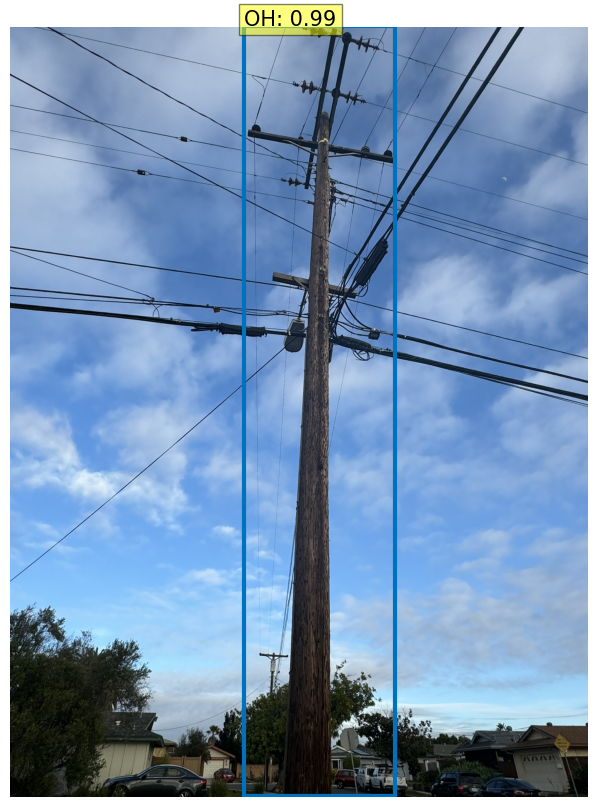

In [42]:
# DETR results on randomly chosen training image
img_name = '/content/data/structures/train2017/IMG_1191.JPEG'
im = Image.open(img_name)

run_worflow(im,
            model, "/content/data/structures/finetuned/trial")

### Display Validation Image Results

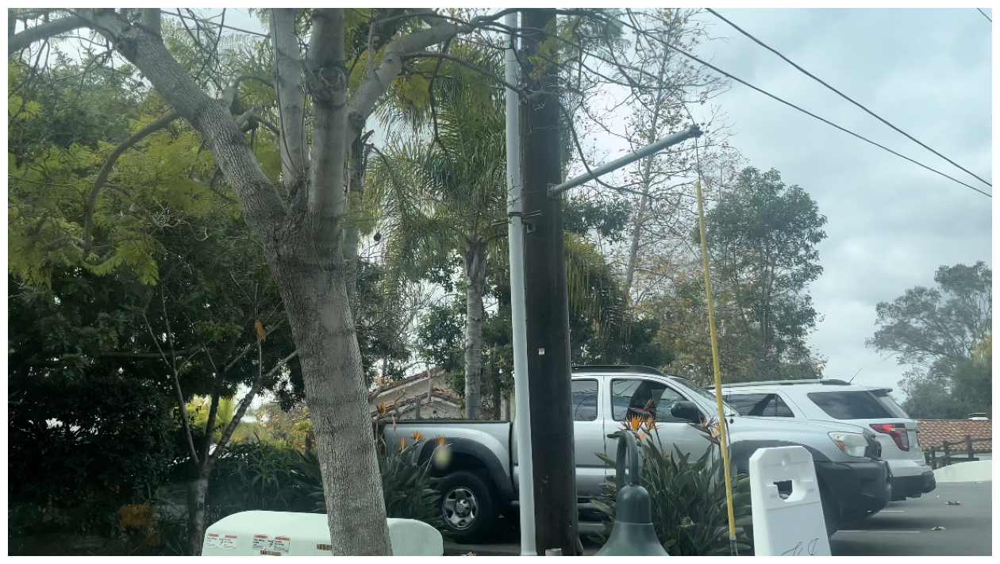

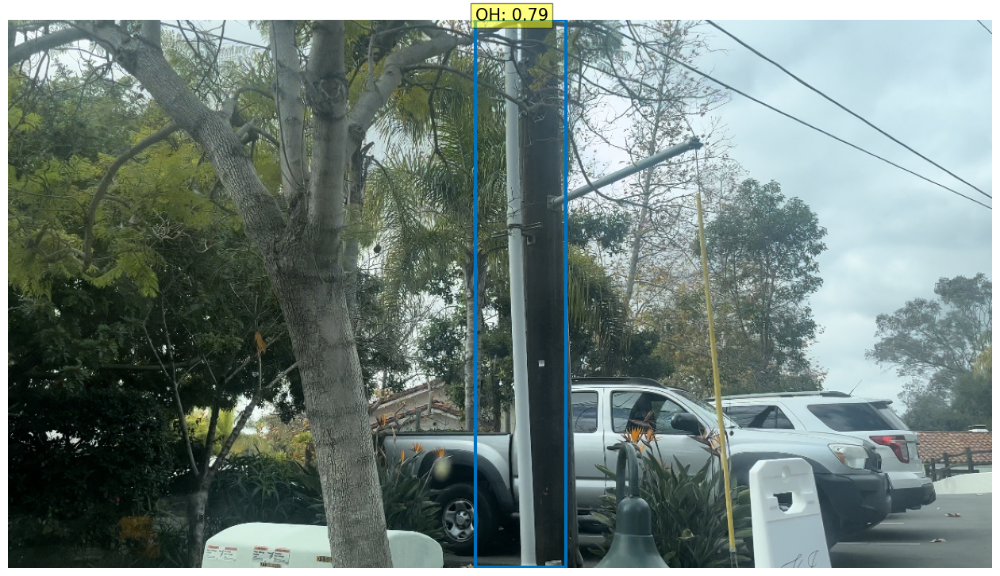

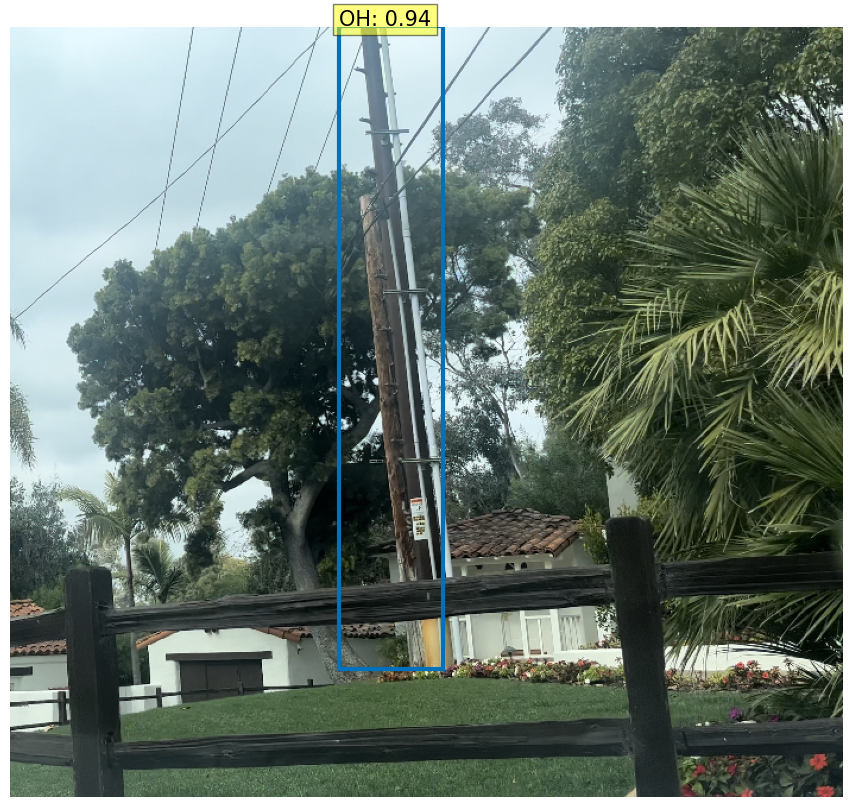

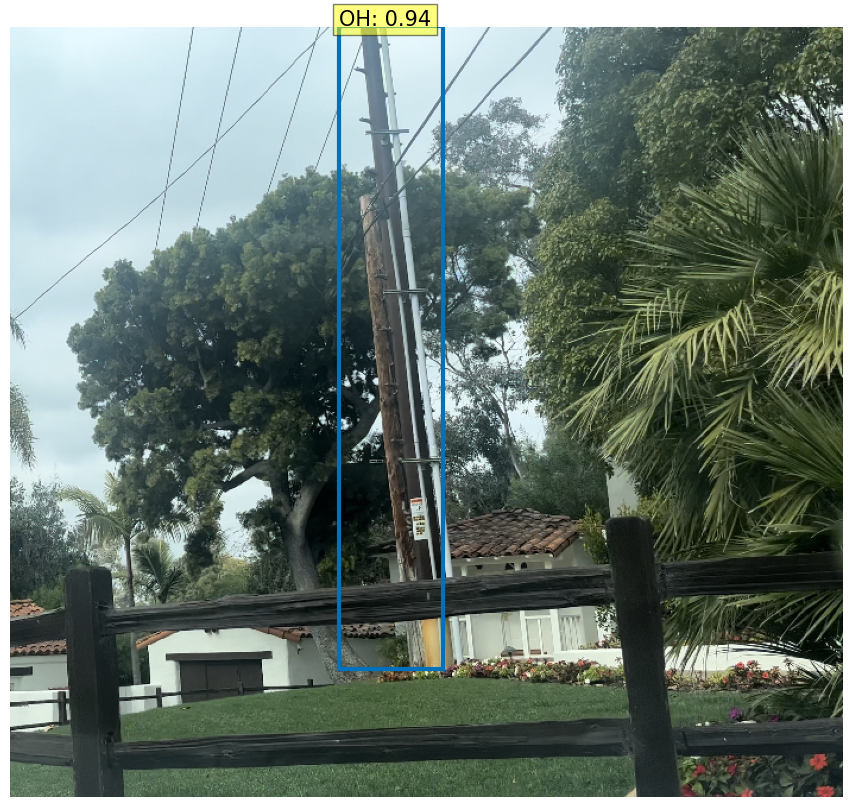

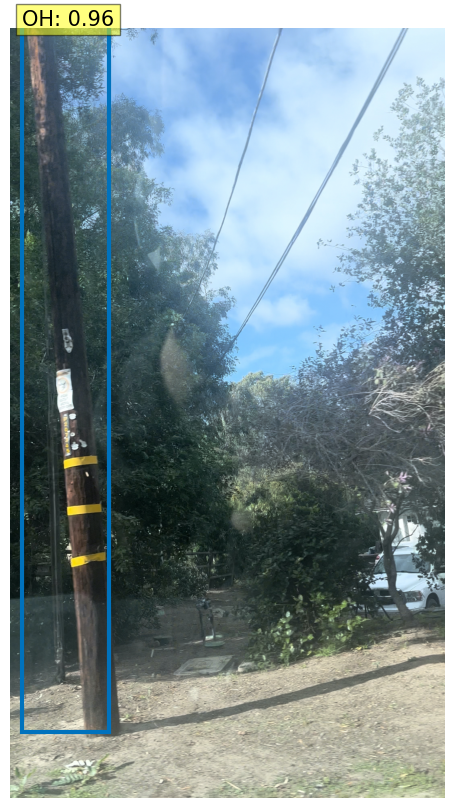

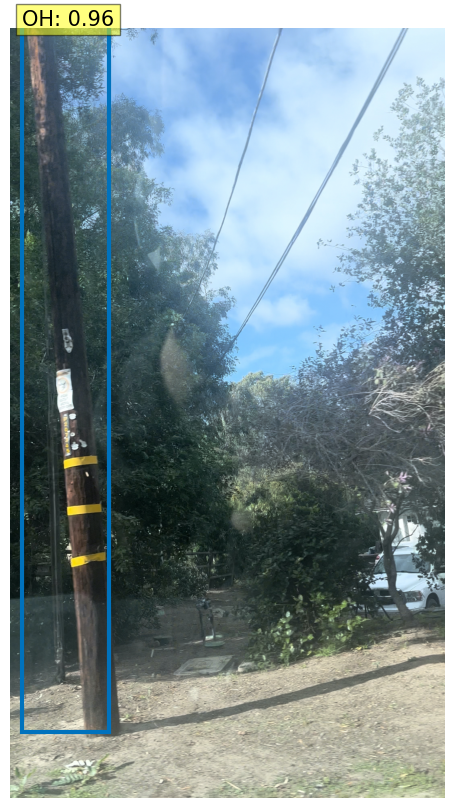

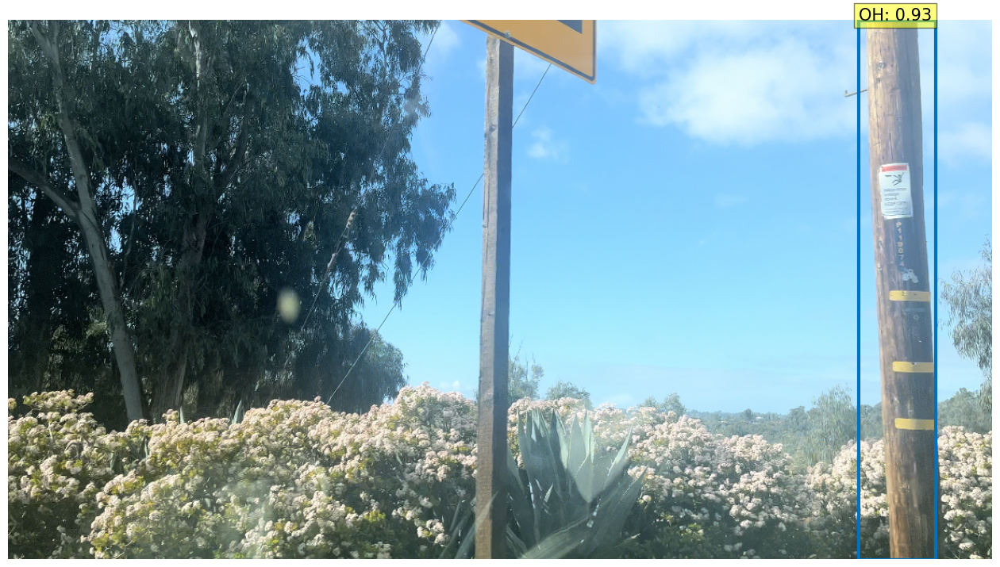

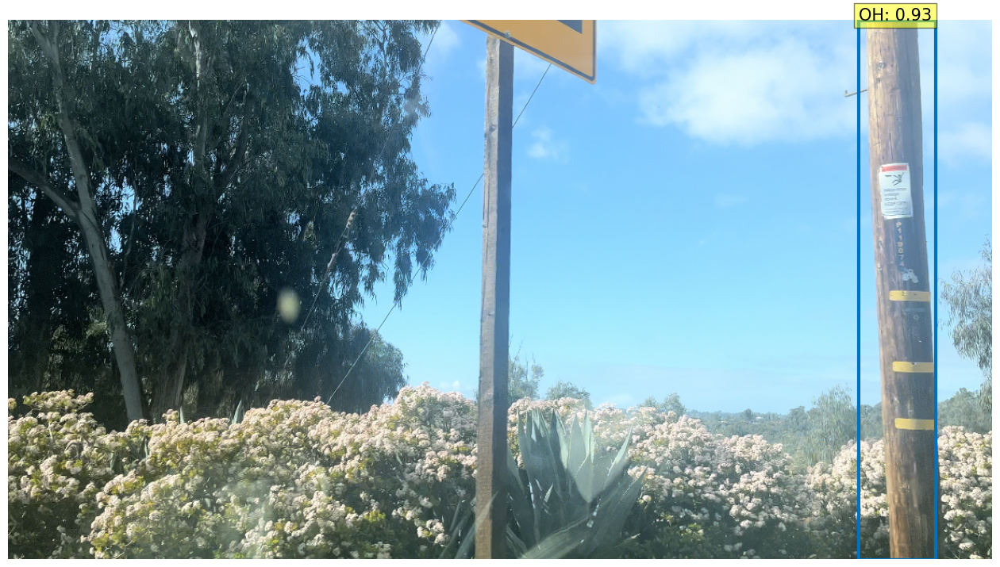

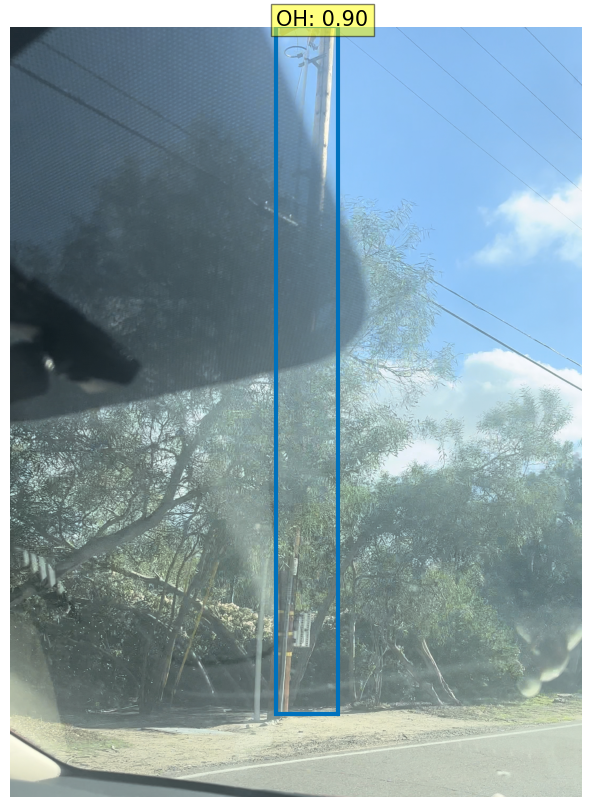

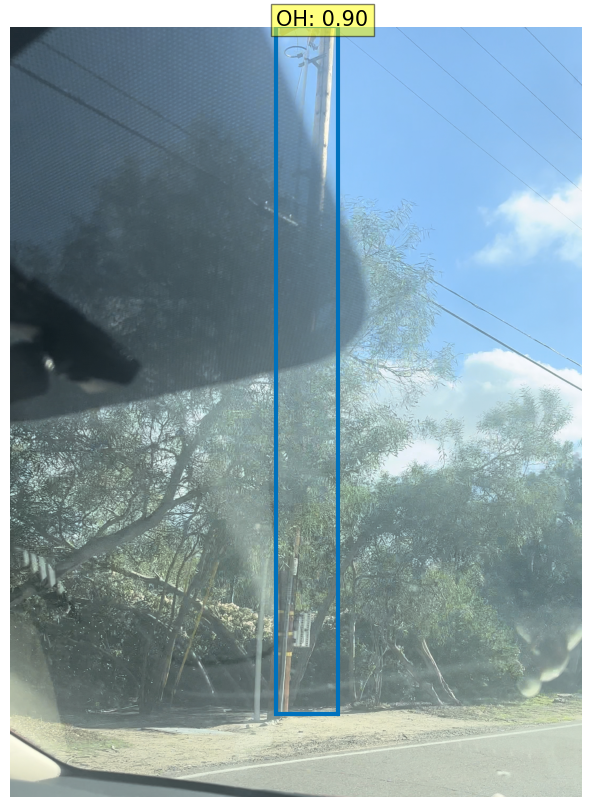

In [46]:
# Display validation results on set of 5 images
from glob import glob

val_images = glob('/content/data/structures/val2017/*.jpg')
img_root = "/content/data/structures/finetuned/val"
for i, img_name in enumerate(val_images):
    if i == 5:
        break
    im = Image.open(img_name)

    img_root = img_root + str(i)
    run_worflow(im,model, img_root)

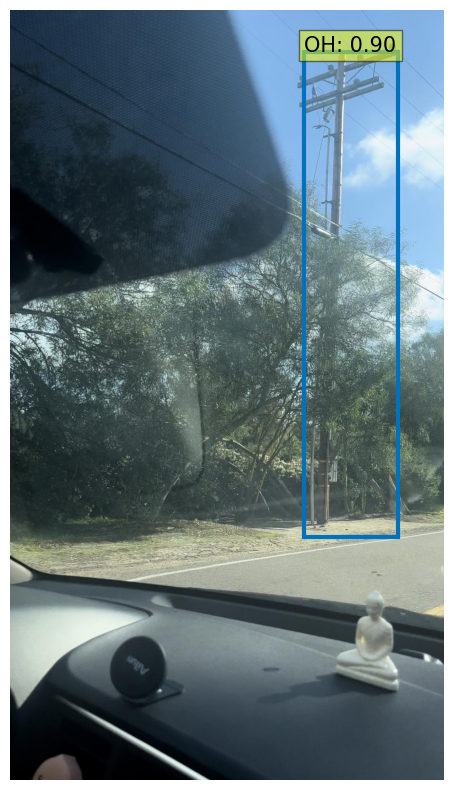

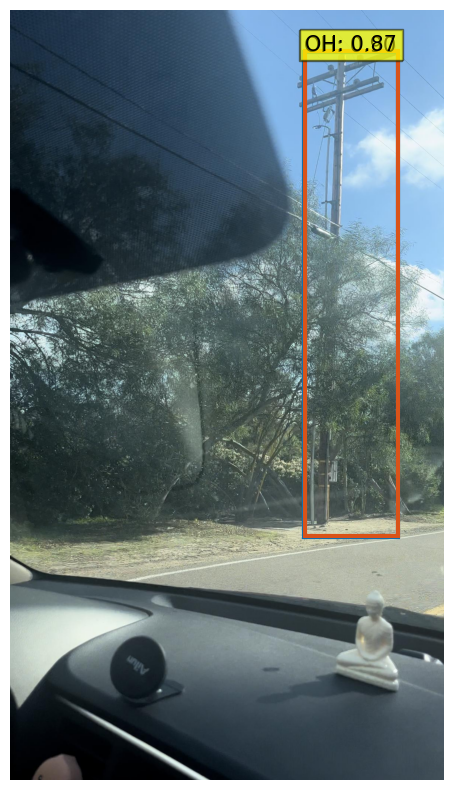

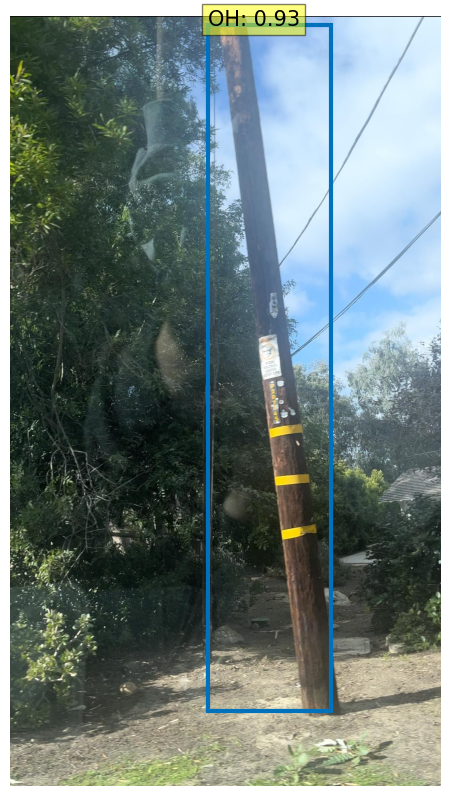

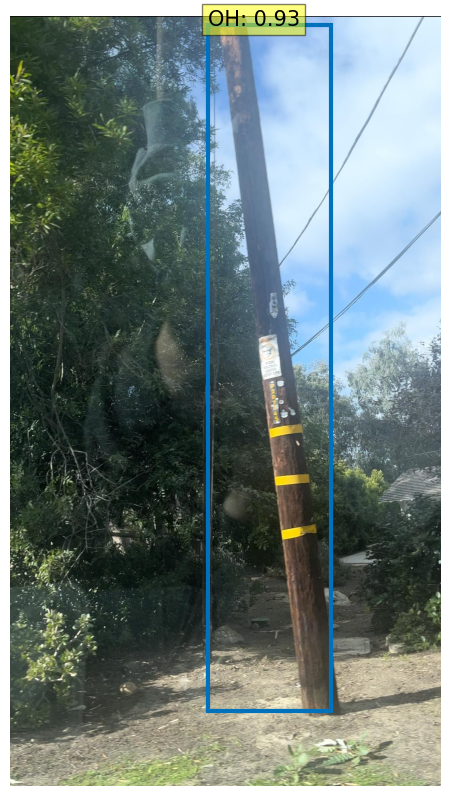

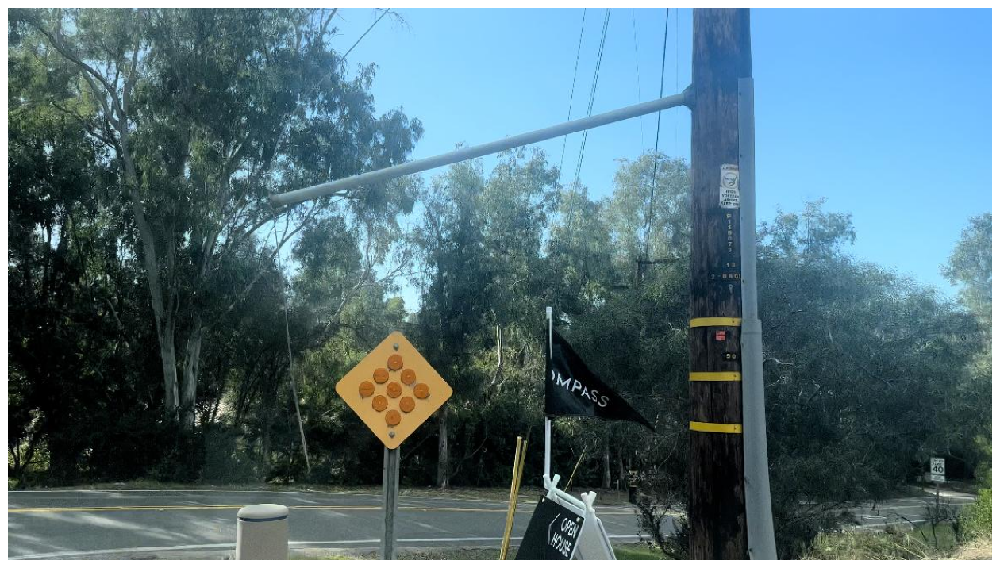

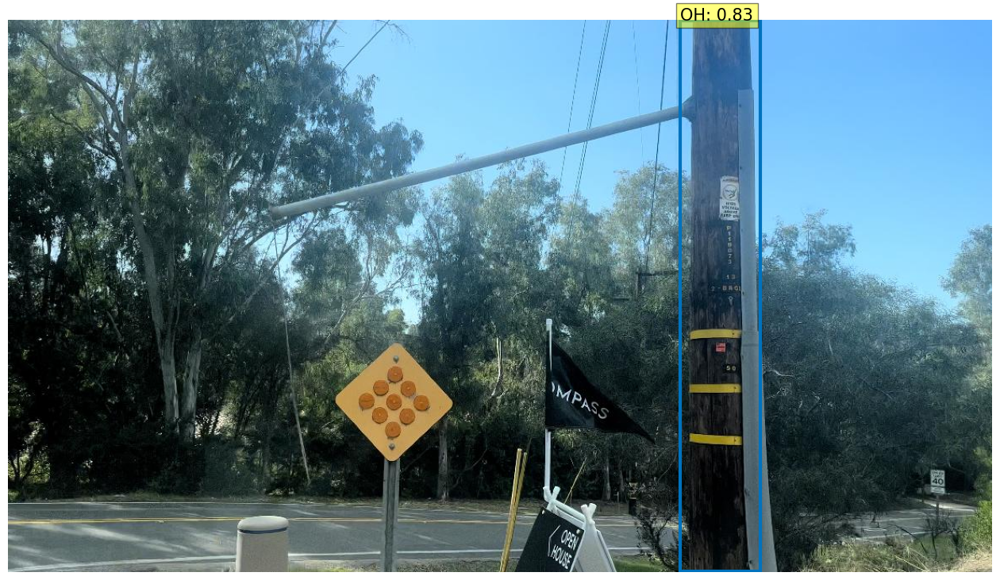

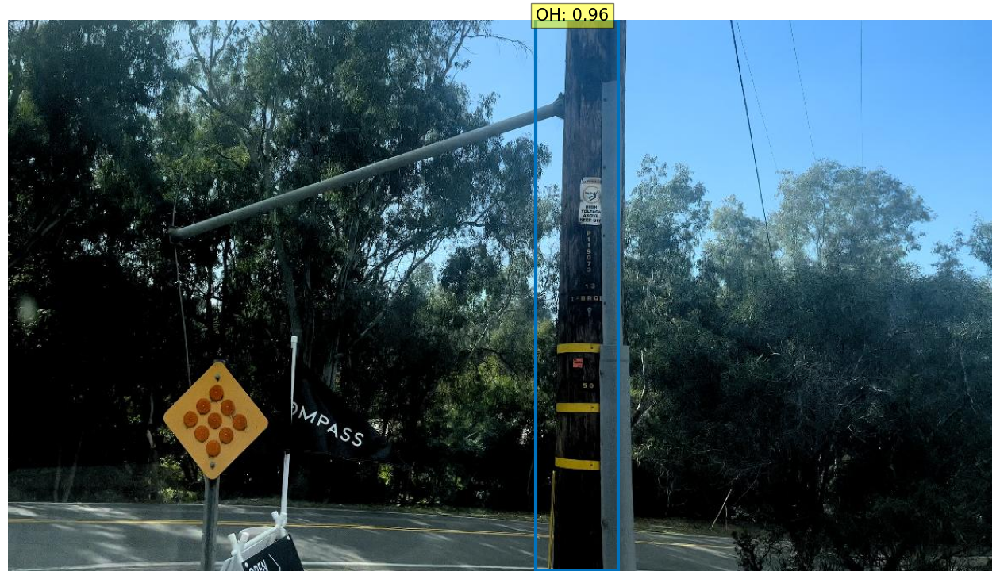

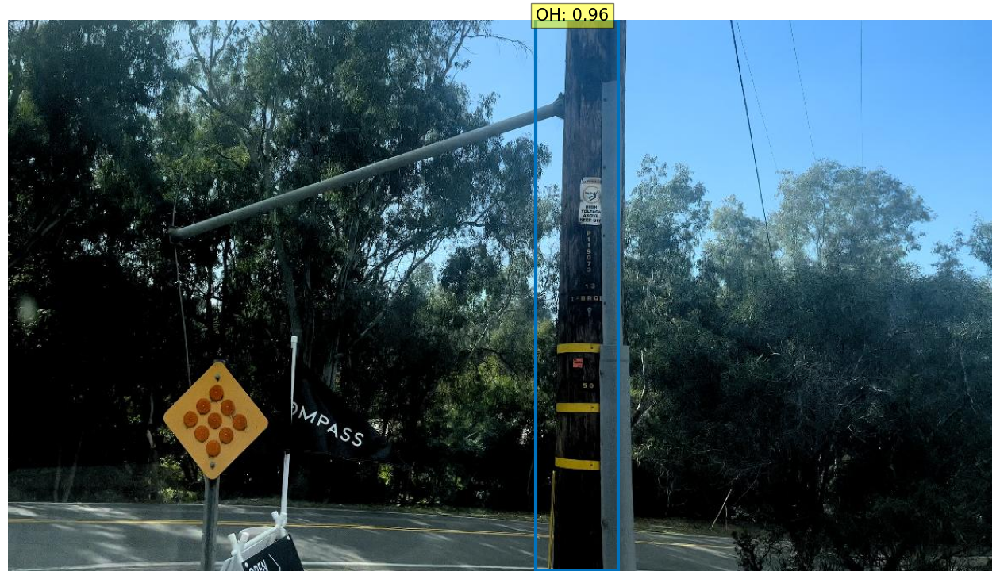

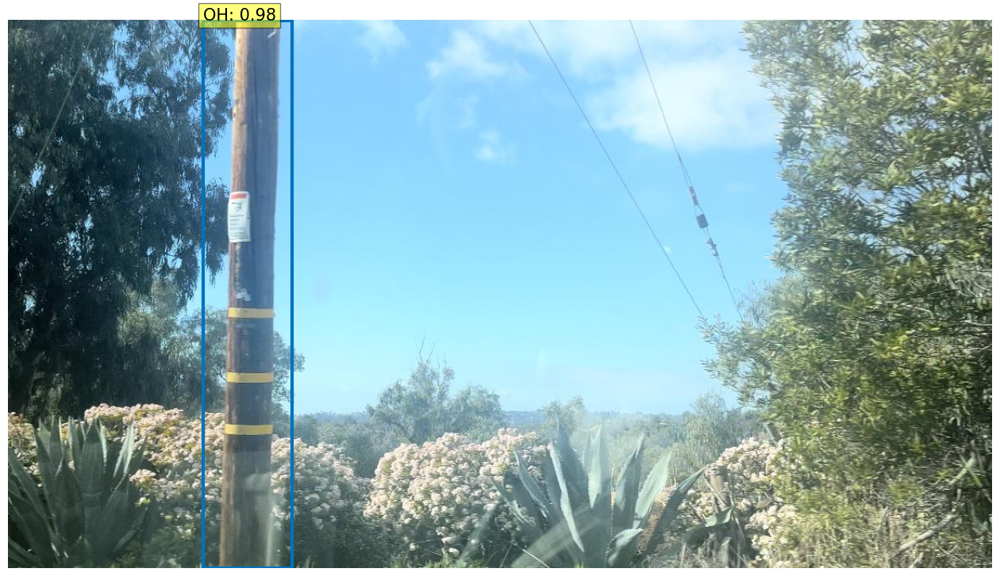

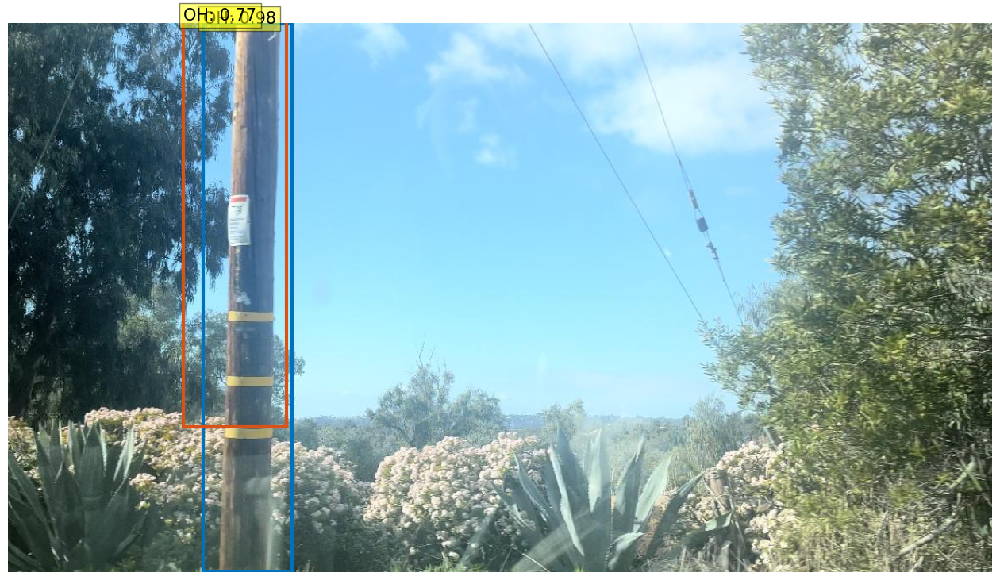

In [47]:
# Display validation results on set of png turned jpg images
valjpg_images = glob('/content/data/structures/valjpg/*.jpg')
img_root = "/content/data/structures/finetuned/valid"
for i, img_name in enumerate(valjpg_images):
    if i == 5:
        break
    im = Image.open(img_name)

    img_root = img_root + str(i)
    run_worflow(im,model, img_root)

As seen in the images above, the DETR model, in each iteration of the image, presents further inspections of the image with its deductions on the target object within the photo. Accordingly, the number of bounding boxes increase as DETR inspects further with less confidence.

For each bounding box, a label and DETR's confidence in the labeling are reflected next to the box. With each iteration of the results, the bounding boxes with lower confidence levels appear more frequently.

We see that while the model does relatively well on poles that show the whole pole, it tends to confuse trees with poles, and has greater difficulty in identifying when the images of the pole are close-up. Yet, for the purposes of our Proof of Concept, the model is adequate and produces promising results.